In [1]:
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from nltk.stem import WordNetLemmatizer, SnowballStemmer
import pandas as pd
import matplotlib.pyplot as plt
import os, shutil, glob, os.path
from gensim import corpora, models

In [2]:
data = pd.read_csv(r'D:\Projectinsta\images_hashtags.csv')
print(data.shape)
data.head(20)

(51025, 3)


,country_code,cluster_no,hashtags
0,AE,0,"['#modellife', '#actor', '#karimafghani', '#aj..."
1,AE,0,"['#modellife', '#actor', '#karimafghani', '#aj..."
2,AE,1,"['#cintabuta', '#hondacivic']"
3,AE,1,"['#cintabuta', '#hondacivic']"
4,AE,1,"['#dubai', '#dubai🇦🇪', '#dubaimarina', '#dubai..."
5,AE,2,"['#LUXXEPROTECT', '#LUXXEWHITE', '#LUXXESLIM',..."
6,AE,2,"['#LUXXEPROTECT', '#LUXXEWHITE', '#LUXXESLIM',..."
7,AE,2,"['#teambuilding', '#uae', '#wonderlead', '#lea..."
8,AE,2,"['#teambuilding', '#team', '#outdoor', '#activ..."
9,AE,2,[]


In [3]:
country_list=data.country_code.unique().tolist()
len(country_list)

64

In [4]:
# countries from caption topics of covid19
#top_countries=['US', 'ID', 'BR', 'IN', 'GB', 'ES', 'AR', 'TR', 'MX', 'CA']

In [5]:
stemmer = SnowballStemmer('english')
def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text):
    result = []
    for token in gensim.utils.simple_preprocess(text):
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 3:
            result.append(lemmatize_stemming(token))
    return result

In [6]:
clean_sentences = pd.DataFrame(columns=['country_code','hash_sentence','cluster_no'])

In [7]:
import string, nltk, re
exclude = set(string.punctuation)
words = set(nltk.corpus.words.words())

In [8]:
for country in country_list:
    per_con = data.loc[(data['country_code'] == country )]
    clusters = per_con.cluster_no.nunique()
    for i in range(clusters+1):
        sentences = pd.DataFrame(per_con.loc[per_con['cluster_no'] == i ,'hashtags'])['hashtags'].tolist()
        #print(sentences)
        #break
        #sentence = ''.join(sentences).strip()
        for s in sentences:
            if len(s)<1:
                continue
            hash_free = re.sub(r"#", "", s)
            #print(hash_free)
            num_free = re.sub(r"\d+","",hash_free)
            punc_free = ''.join(ch for ch in num_free if ch not in exclude)
            otherlang_free = ''.join(ch for ch in punc_free if ((ch in words) or ch == ' '))
            #print(otherlang_free)
            #break
            cleaned = preprocess(otherlang_free)
            if len(cleaned)<1:
                   continue
            cleaned = ' '.join(cleaned)
            clean_sentences = clean_sentences.append({'country_code':country,'hash_sentence':cleaned,'cluster_no': i},ignore_index=True)
        
        #print(sentence)
        #print(cleaned)

In [21]:
print(clean_sentences.shape)
clean_sentences.head(8)

(46726, 3)


,country_code,hash_sentence,cluster_no
0,AE,modellif actor karimafghani ajman abudhabi kab...,0
1,AE,modellif actor karimafghani ajman abudhabi kab...,0
2,AE,cintabuta hondaciv,1
3,AE,cintabuta hondaciv,1
4,AE,dubai dubai dubaimarina dubaimal frame burduba...,1
5,AE,luxxeprotect luxxewhit luxxeslim luxxerenew ce...,2
6,AE,luxxeprotect luxxewhit luxxeslim luxxerenew ce...,2
7,AE,teambuild wonderlead leadership team dubai busi,2


In [22]:
clean_sentences.isna().sum()

country_code     0
hash_sentence    0
cluster_no       0
dtype: int64

In [26]:
import pandas as pd
hash_topics_generated = pd.DataFrame(columns=['country_code','cluster_no','topic_no','topics'])

In [27]:
for country in country_list:
    per_con = clean_sentences.loc[(clean_sentences['country_code'] == country )]
    clusters = per_con.cluster_no.nunique()
    print(country)
    for i in range(clusters+1):
        #if i==1:
            #break
        sentences = per_con.loc[((per_con['country_code'] == country)&(per_con['cluster_no'] == i)),'hash_sentence'].tolist()
        #print(sentences)
        processed_docs1 = [preprocess(item) for item in sentences]
        #print(processed_docs1)
        dictionary1 = corpora.Dictionary(processed_docs1)
        bow_corpus = [dictionary1.doc2bow(doc) for doc in processed_docs1]
        tfidf = models.TfidfModel(bow_corpus)
        corpus_tfidf = tfidf[bow_corpus]
        l=len(sentences)
        #print(l)
        #to ignore rows where list has no sentences
        if l<1:
            continue
        if l<10:
            num_topics = 1
            print('cluster:',i)
        elif l<30:
            num_topics = 2
            print('cluster:',i)
        elif l<100:
            num_topics = 5
            print('cluster:',i)
        else:
            num_topics = 10
            print('cluster:',i)
        lda_model = gensim.models.ldamodel.LdaModel(corpus=corpus_tfidf,id2word=dictionary1,num_topics=num_topics, passes=2, random_state=1)
        x = lda_model.print_topics()
        topicwords={}
        for topic,word in x:
            wordlist=(re.sub('[^A-Za-z ]+', '', word)).split()
            topicwords[topic]=wordlist
        #print(topicwords)
        for key,value in topicwords.items():
            hash_topics_generated = hash_topics_generated.append({'country_code':country,'cluster_no':i, 'topic_no': key,'topics':value},ignore_index=True)

AE
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 6
cluster: 7
AR
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
cluster: 6
cluster: 7
cluster: 8
cluster: 9
AT
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
AU
cluster: 0
cluster: 2
cluster: 3
cluster: 4
cluster: 5
cluster: 7
cluster: 8
BE
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
BO
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
BR
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
cluster: 6
cluster: 7
cluster: 8
cluster: 9
CA
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
cluster: 6
cluster: 7
cluster: 9
CH
cluster: 0
cluster: 2
cluster: 3
cluster: 4
cluster: 5
CL
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
cluster: 6
cluster: 7
cluster: 8
cluster: 9
CN
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster: 5
CO
cluster: 0
cluster: 1
cluster: 2
cluster: 3
cluster: 4
cluster

In [28]:
print(hash_topics_generated.shape)
hash_topics_generated.head(20)

(2073, 4)


,country_code,cluster_no,topic_no,topics
0,AE,0,0,"[kabul, fashionstyl, smile, photographi, mrkar..."
1,AE,1,0,"[cintabuta, hondaciv, dubai, dubaimarina, luxu..."
2,AE,2,0,"[stayhom, staysaf, style, bangkok, captain, ex..."
3,AE,2,1,"[pandemiclif, writetoyourself, growthroughit, ..."
4,AE,2,2,"[hospit, alainuniv, dubai, cleanroom, clinic, ..."
5,AE,2,3,"[dubaicovid, covidprotect, antenat, beauti, sk..."
6,AE,2,4,"[cloth, shein, global, sale, abudhabi, vaccin,..."
7,AE,2,5,"[forexkorea, forexbahrain, forexsweden, qatar,..."
8,AE,2,6,"[teamx, smarthom, smarthometech, smarthous, du..."
9,AE,2,7,"[mask, staysaf, medic, almahealth, chronicil, ..."


In [29]:
hash_topics_generated.to_csv (r'D:\Projectinsta\hashtag_topics.csv', header=True, index=False)

In [30]:
from IPython.display import display
def cloud(words):
    fig, axes = plt.subplots(2, 5, figsize=(30,4))
    
    for i, ax in enumerate(axes.flatten()):
        fig.add_subplot(ax)
        try:
            topic_words = str(words[i])
            cloud = WordCloud()
            cloud.generate(topic_words)
            fig.subplots_adjust(top = 1.5)
            plt.imshow(cloud)
            #plt.show()
            plt.gca().set_title('Cluster ' + str(i), fontsize=30)
            plt.gca().axis('off')
        except IndexError:
            fig.delaxes(ax)
    #plt.imshow(cloud)
    plt.show()
    print('***************************************************************************')

Country :  AE


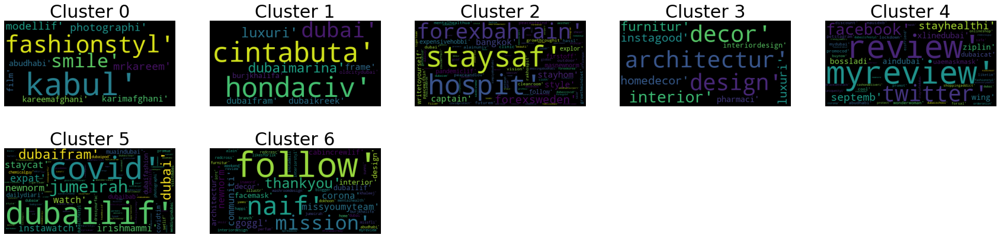

***************************************************************************
Country :  AR


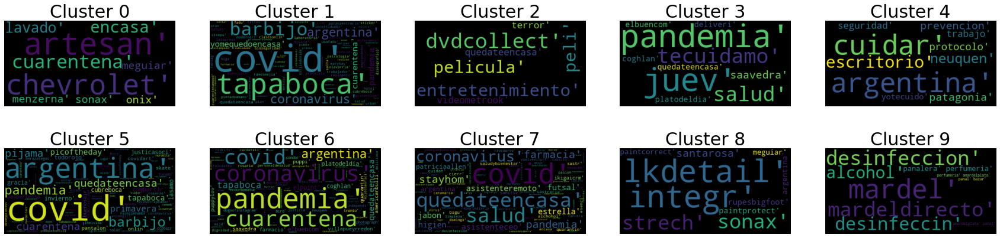

***************************************************************************
Country :  AT


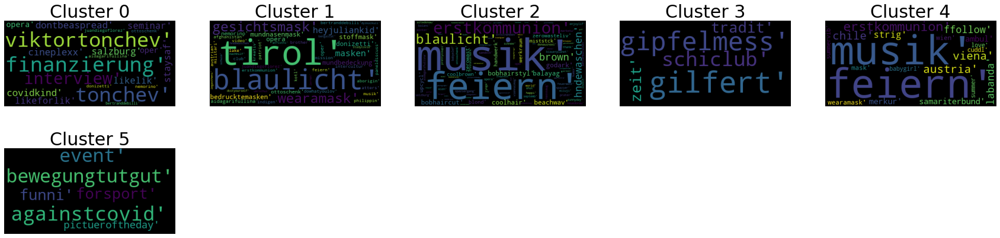

***************************************************************************
Country :  AU


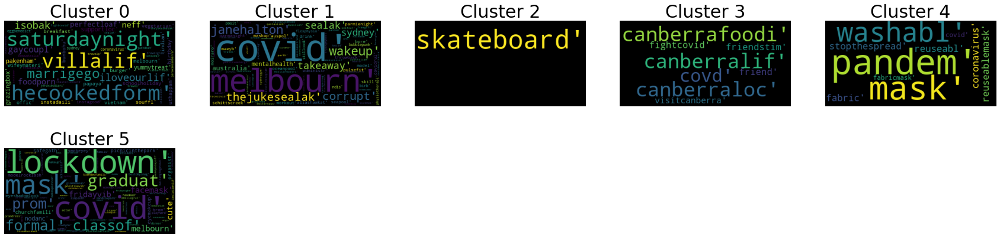

***************************************************************************
Country :  BE


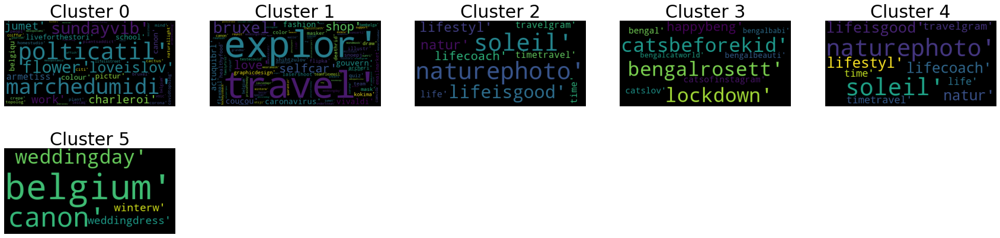

***************************************************************************
Country :  BO


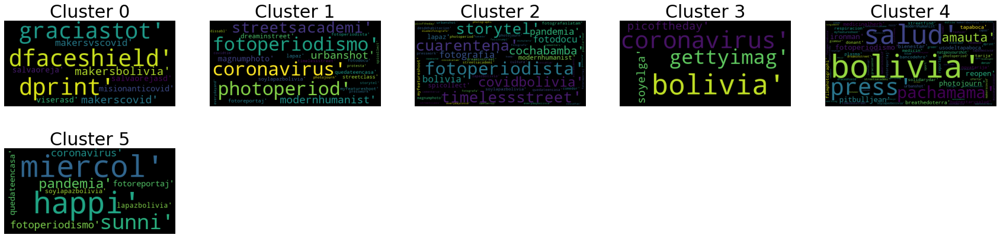

***************************************************************************
Country :  BR


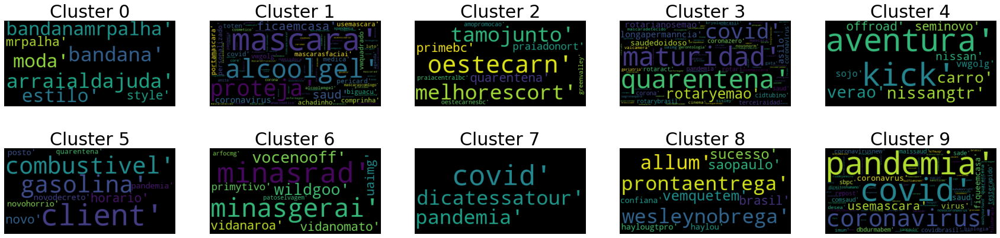

***************************************************************************
Country :  CA


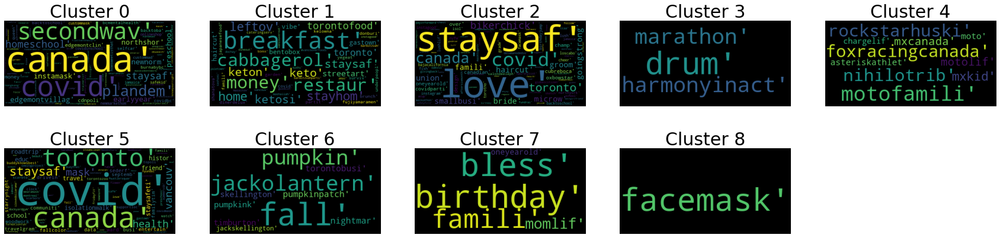

***************************************************************************
Country :  CH


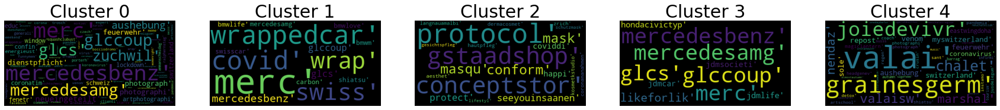

***************************************************************************
Country :  CL


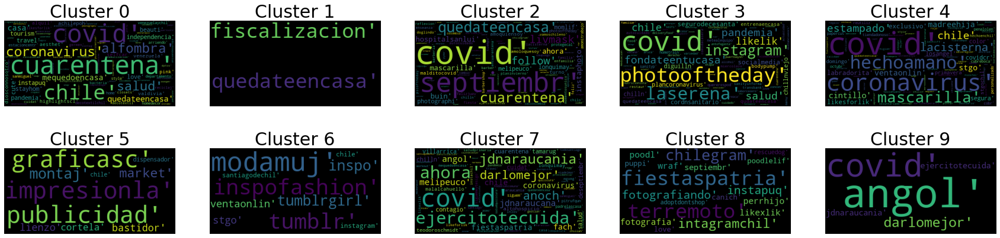

***************************************************************************
Country :  CN


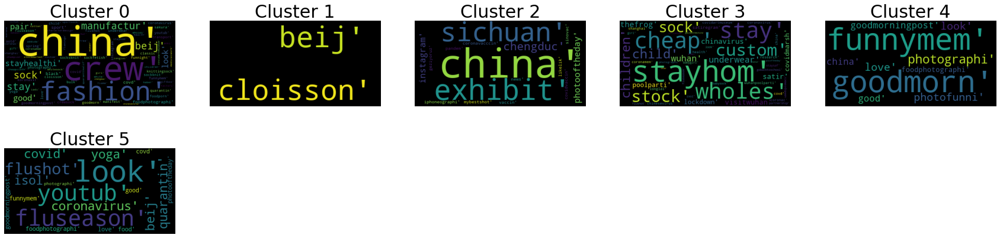

***************************************************************************
Country :  CO


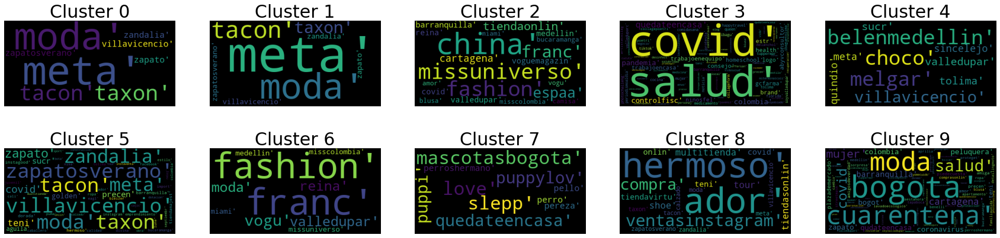

***************************************************************************
Country :  CZ


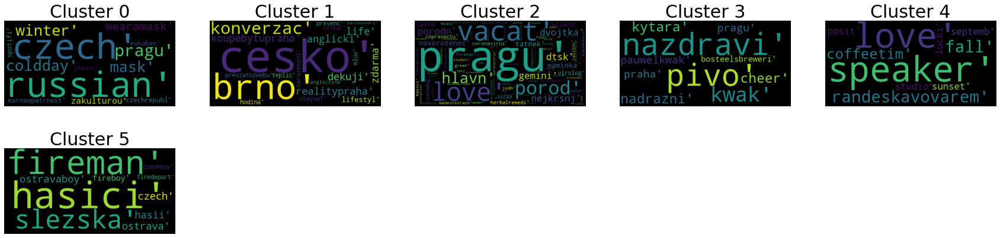

***************************************************************************
Country :  DE


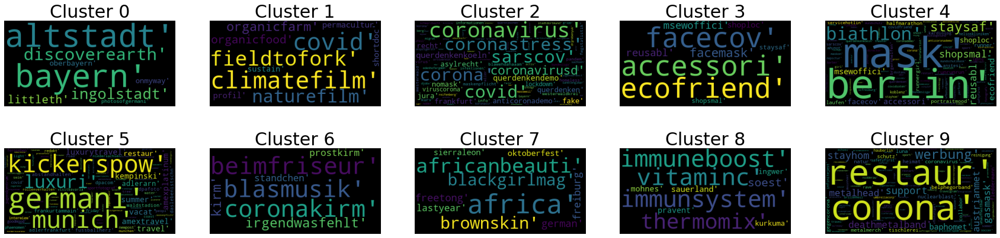

***************************************************************************
Country :  DK


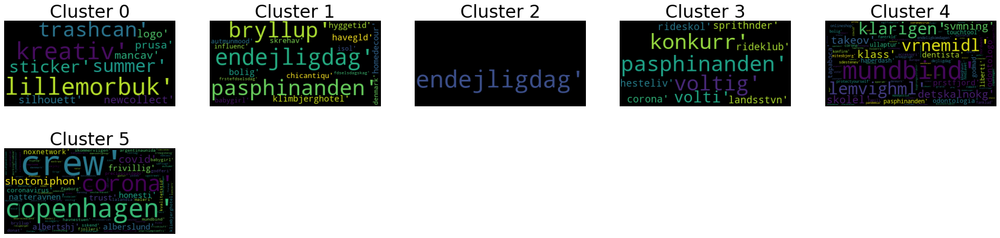

***************************************************************************
Country :  DO


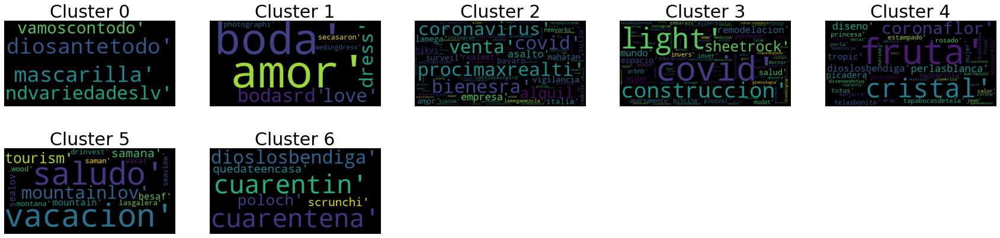

***************************************************************************
Country :  DZ


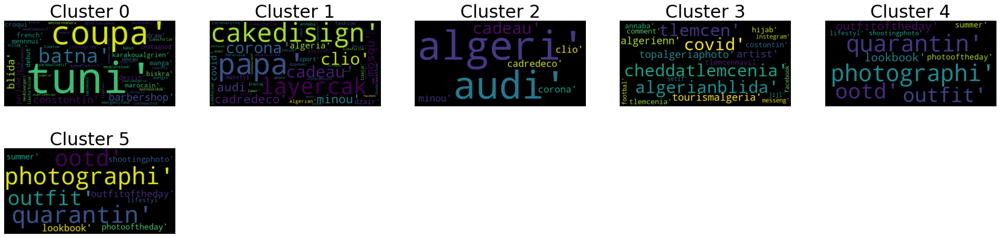

***************************************************************************
Country :  EC


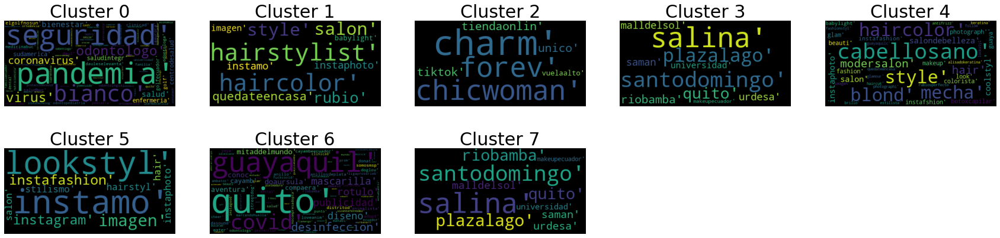

***************************************************************************
Country :  EG


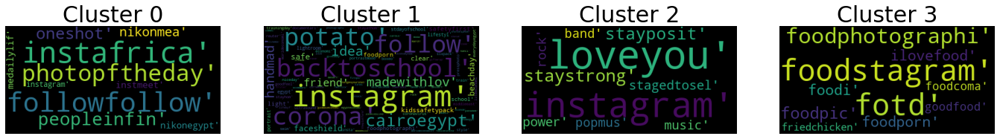

***************************************************************************
Country :  ES


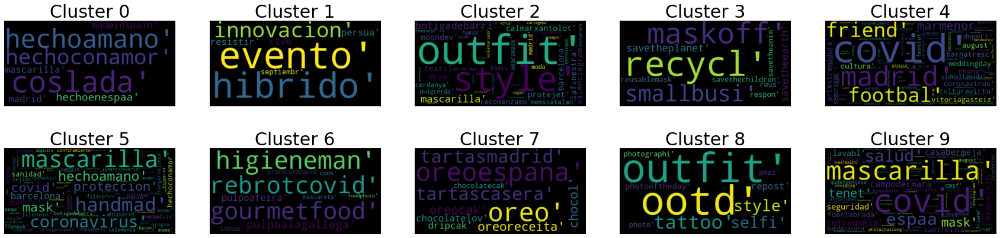

***************************************************************************
Country :  FR


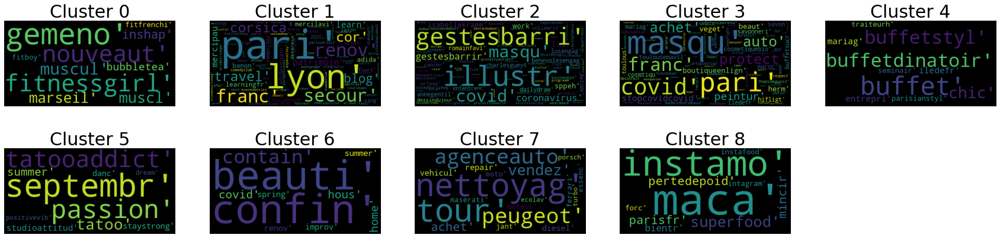

***************************************************************************
Country :  GB


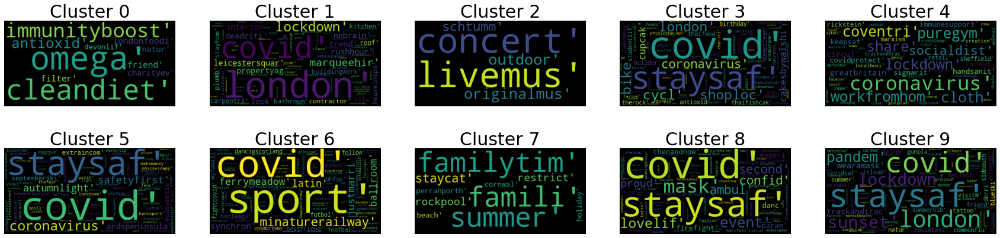

***************************************************************************
Country :  GH


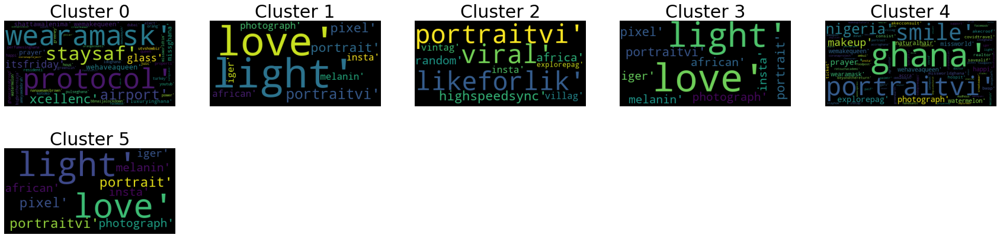

***************************************************************************
Country :  GR


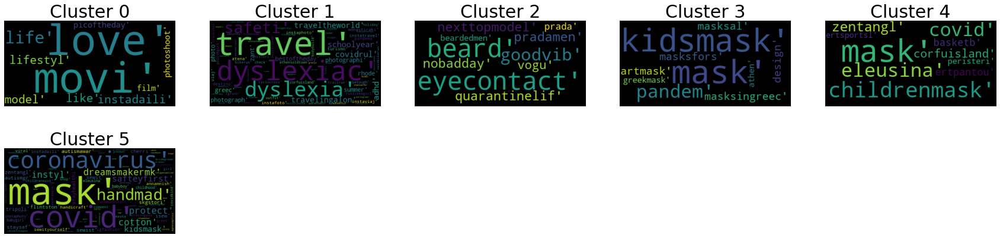

***************************************************************************
Country :  GT


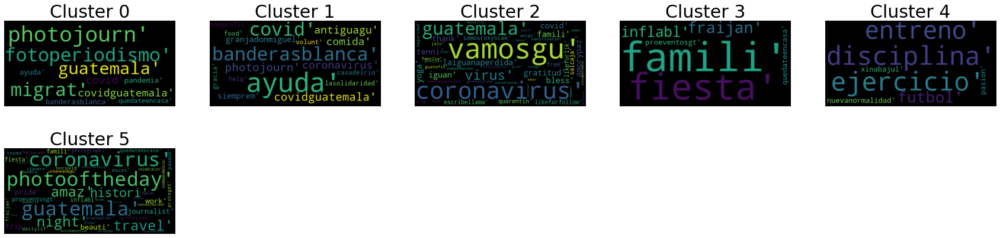

***************************************************************************
Country :  HK


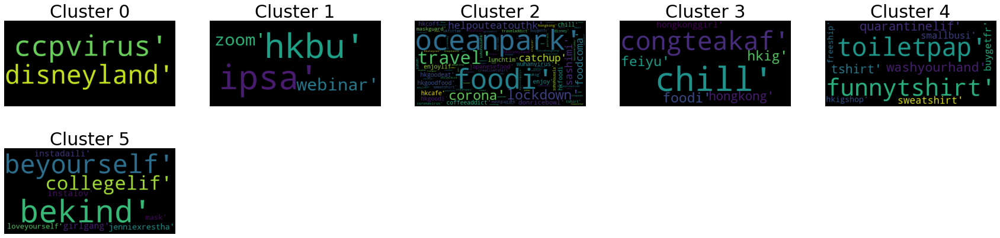

***************************************************************************
Country :  ID


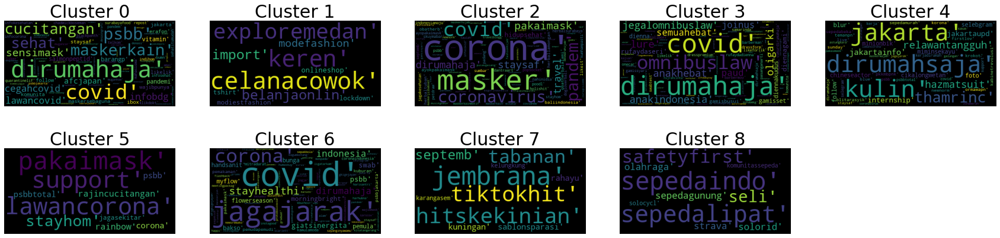

***************************************************************************
Country :  IE


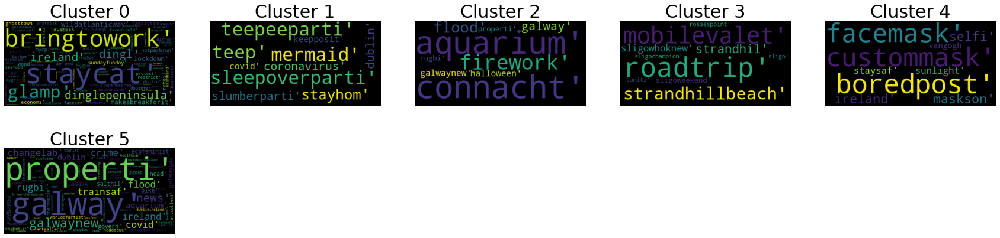

***************************************************************************
Country :  IL


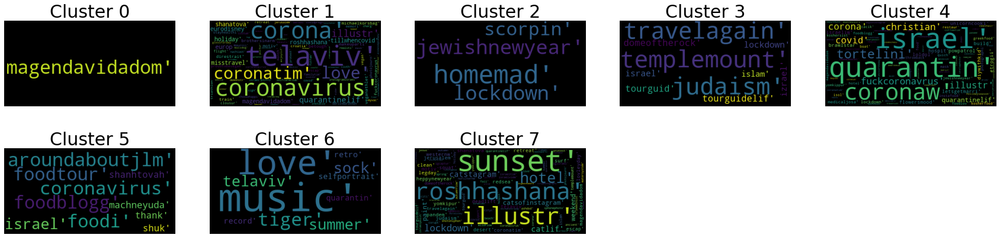

***************************************************************************
Country :  IN


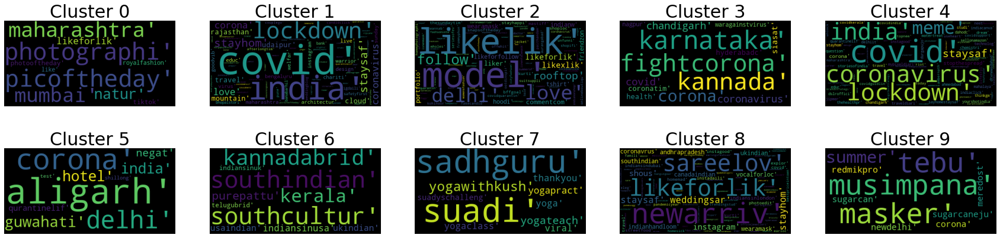

***************************************************************************
Country :  IQ


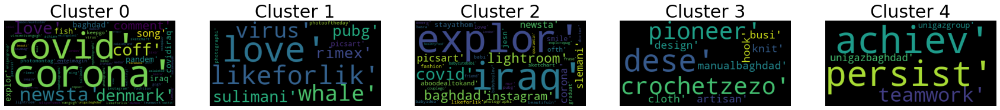

***************************************************************************
Country :  IR


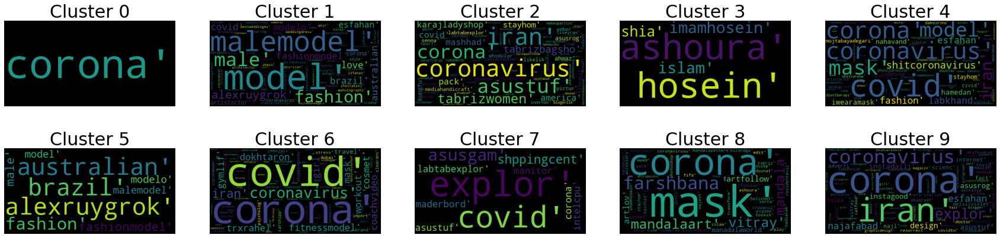

***************************************************************************
Country :  IT


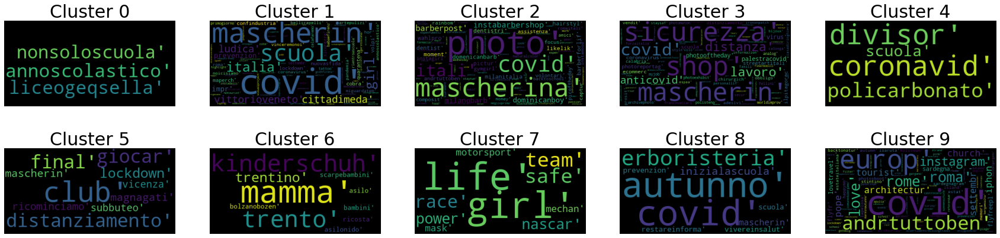

***************************************************************************
Country :  JO


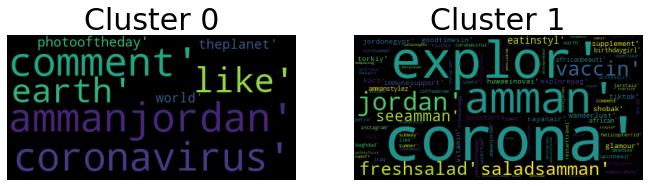

***************************************************************************
Country :  JP


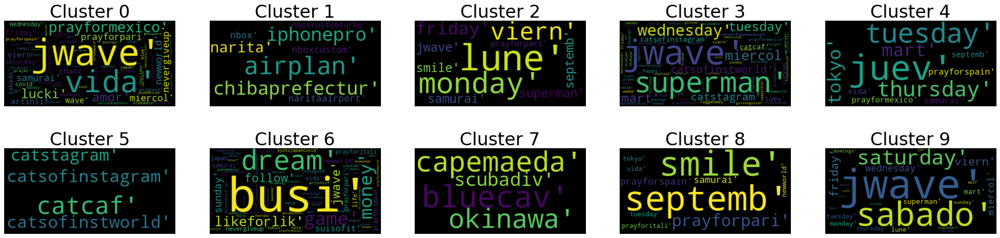

***************************************************************************
Country :  KE


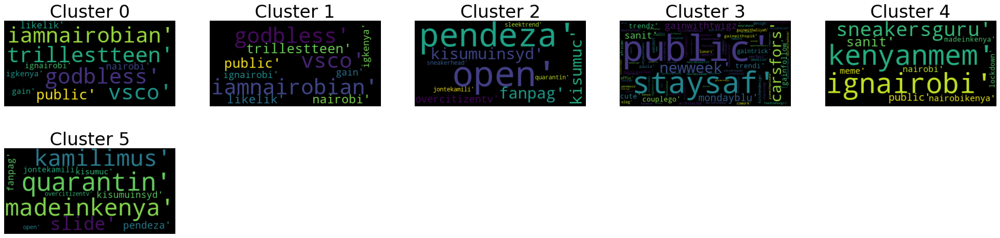

***************************************************************************
Country :  KR


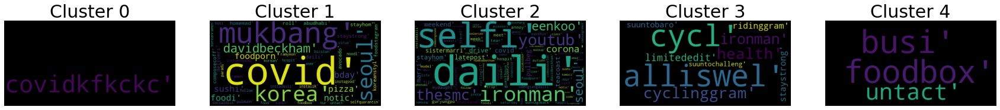

***************************************************************************
Country :  KZ


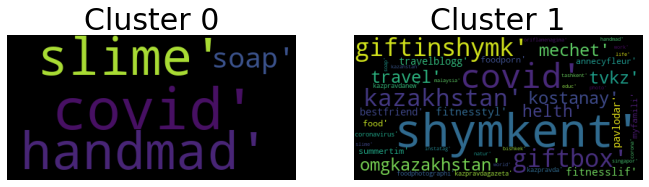

***************************************************************************
Country :  LB


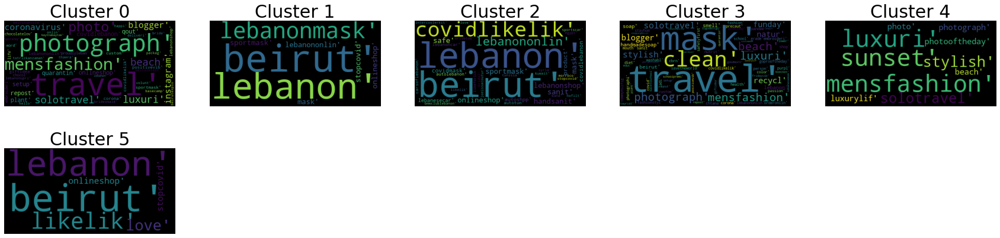

***************************************************************************
Country :  MA


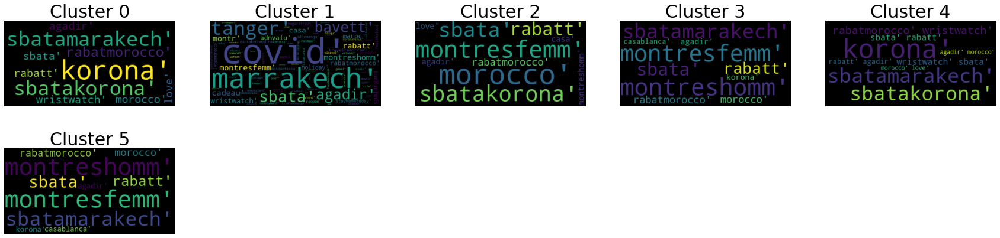

***************************************************************************
Country :  MX


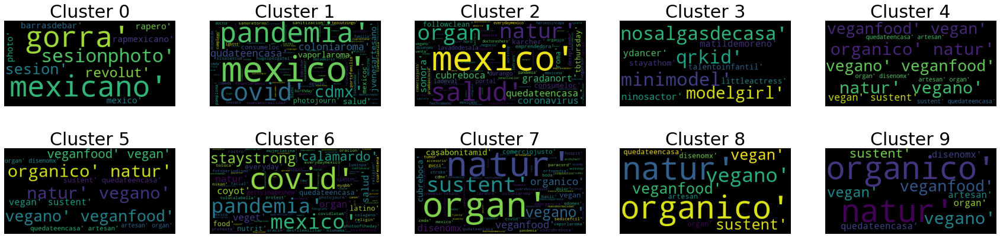

***************************************************************************
Country :  MY


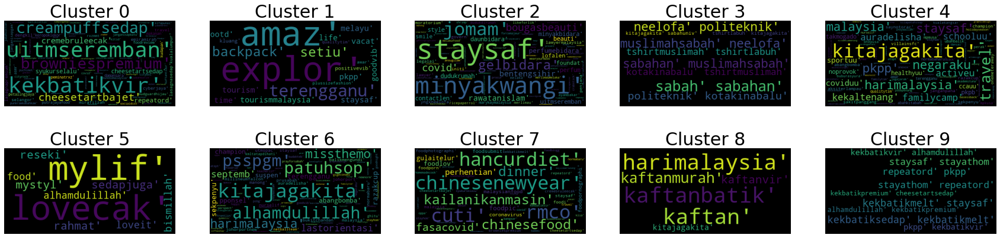

***************************************************************************
Country :  NG


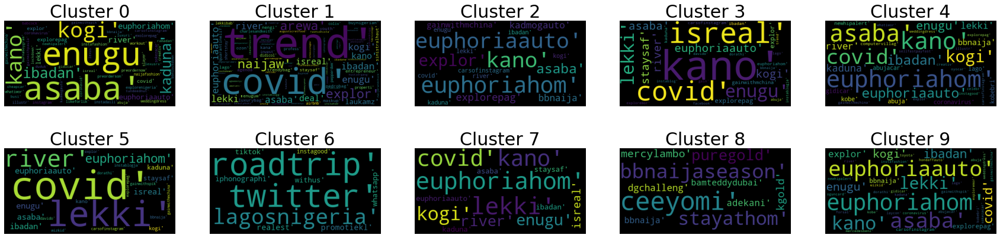

***************************************************************************
Country :  NL


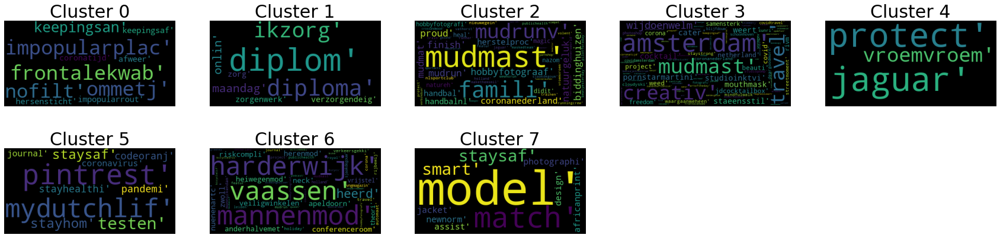

***************************************************************************
Country :  NZ


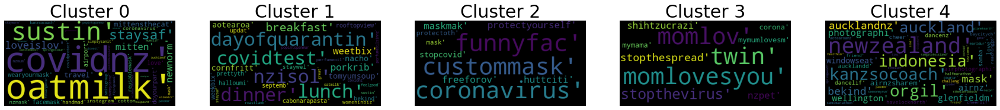

***************************************************************************
Country :  PA


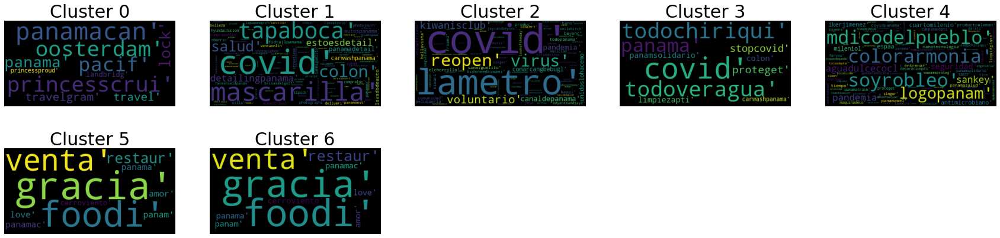

***************************************************************************
Country :  PE


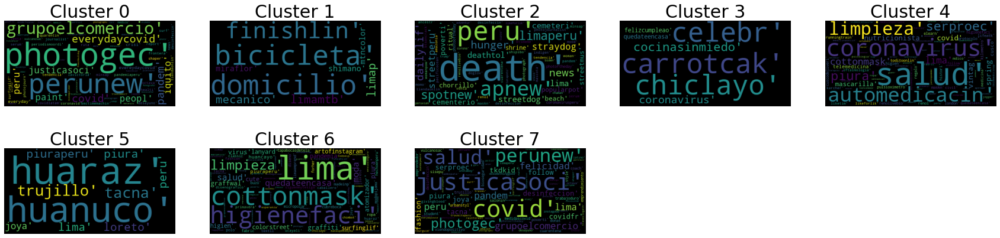

***************************************************************************
Country :  PH


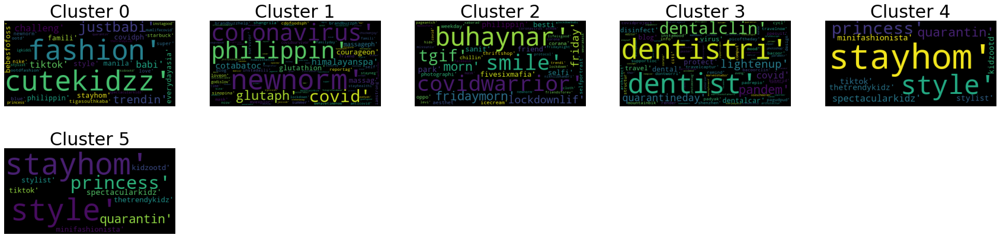

***************************************************************************
Country :  PK


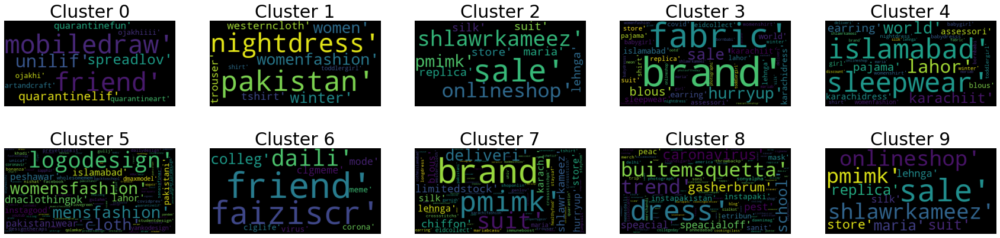

***************************************************************************
Country :  PL


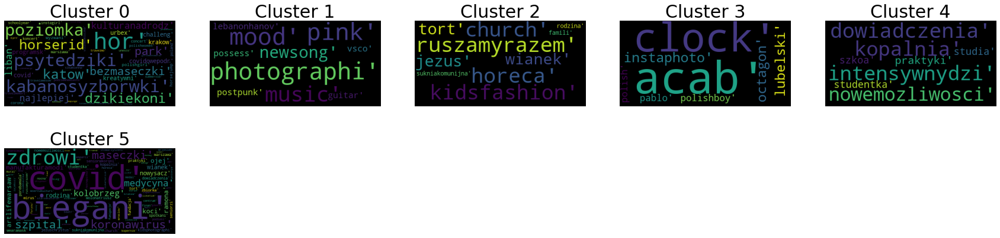

***************************************************************************
Country :  PR


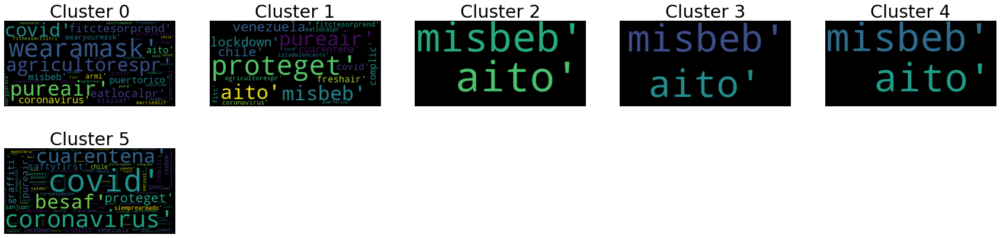

***************************************************************************
Country :  PT


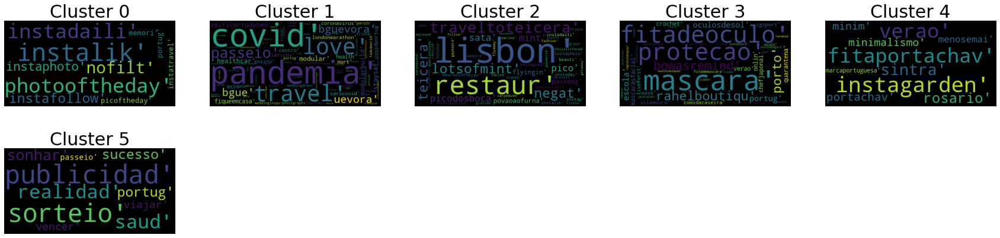

***************************************************************************
Country :  RU


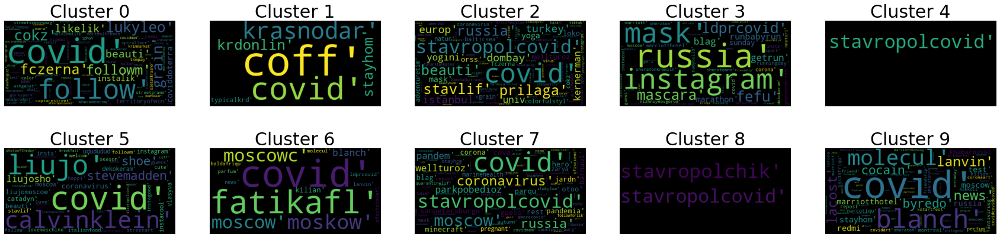

***************************************************************************
Country :  SA


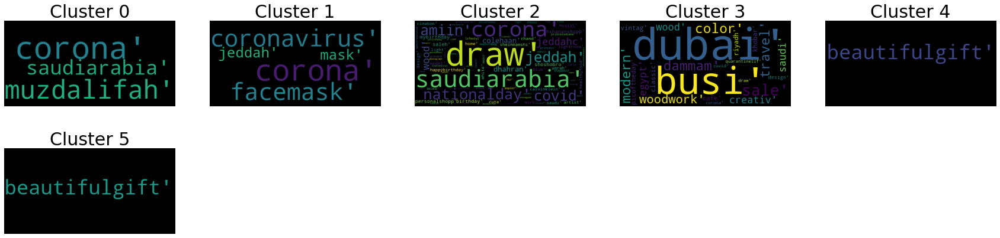

***************************************************************************
Country :  SE


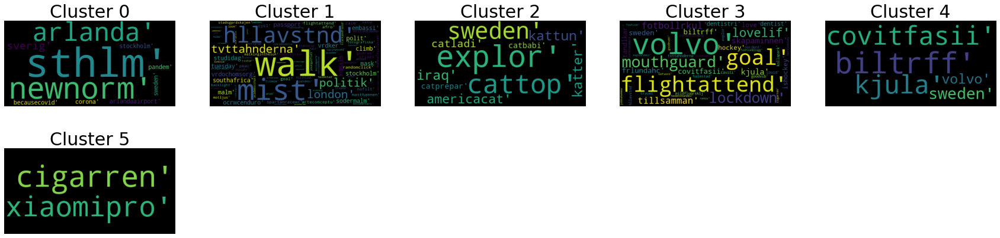

***************************************************************************
Country :  SG


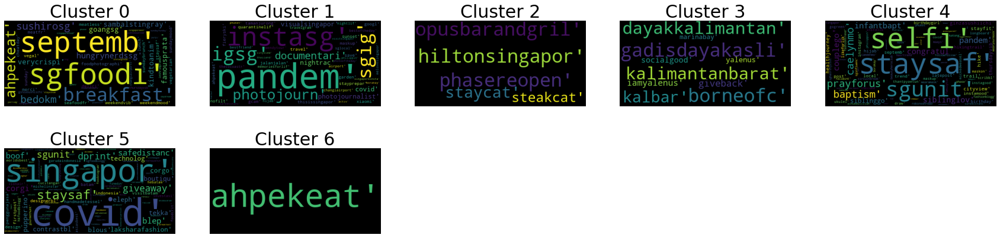

***************************************************************************
Country :  TH


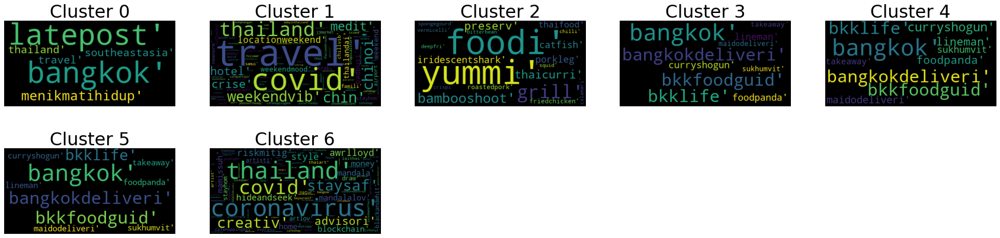

***************************************************************************
Country :  TR


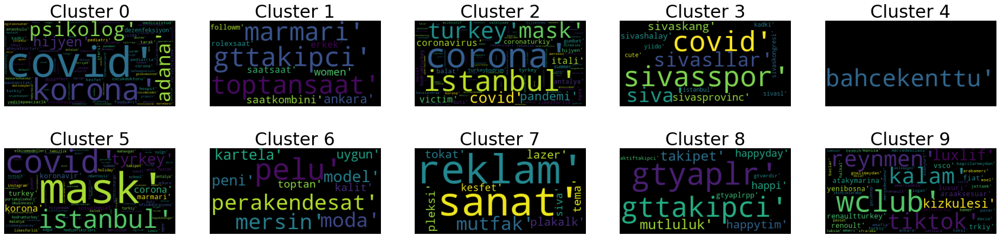

***************************************************************************
Country :  TW


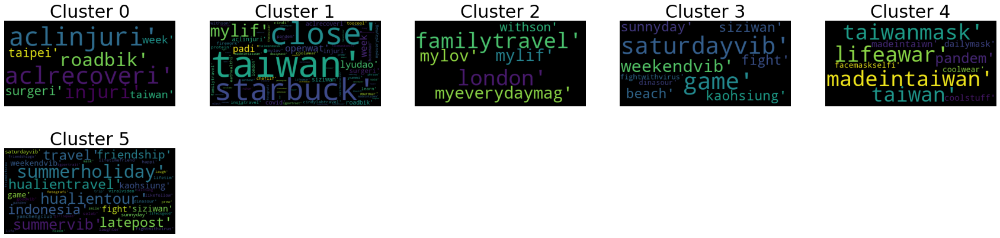

***************************************************************************
Country :  UA


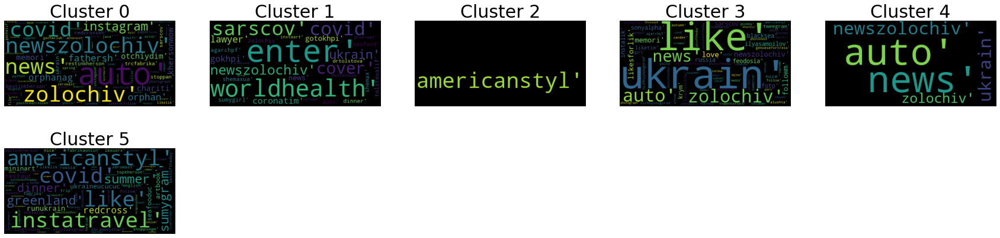

***************************************************************************
Country :  US


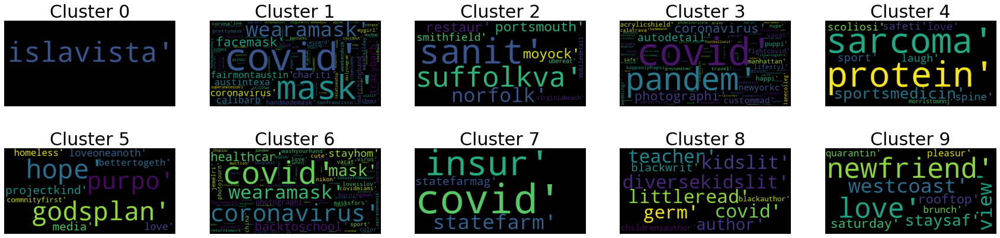

***************************************************************************
Country :  UY


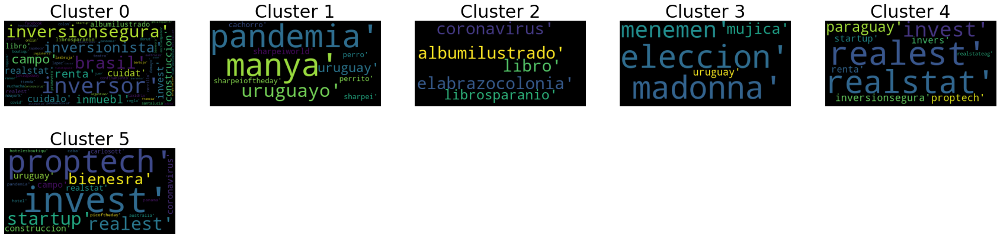

***************************************************************************
Country :  VE


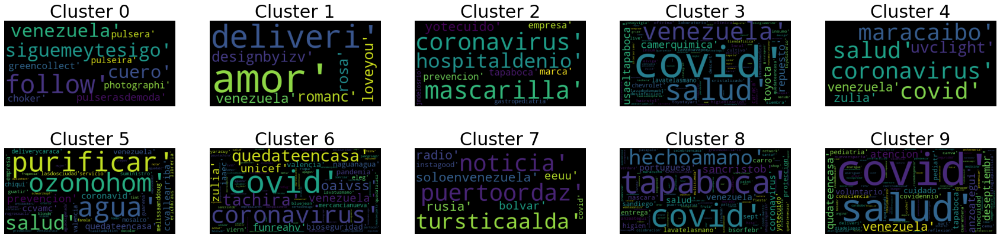

***************************************************************************
Country :  ZA


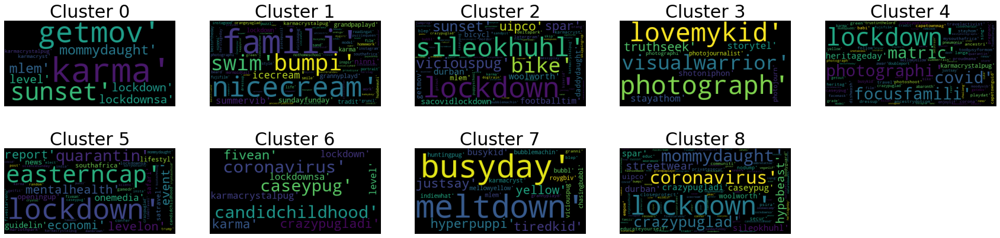

***************************************************************************


In [31]:
from wordcloud import WordCloud
%matplotlib inline
for country in country_list:
    per_con = hash_topics_generated.loc[(hash_topics_generated['country_code'] == country )]
    clusters = per_con.cluster_no.nunique()
    wordlist=[]
    for i in range(clusters+1):
        samp = hash_topics_generated.loc[(hash_topics_generated['country_code']==country) & (hash_topics_generated['cluster_no']==i),['topics']]['topics'].tolist()
        if len(samp)<1:
            continue
        flat_list = [item for sublist in samp for item in sublist]
        wordlist.append(flat_list)
    print('Country : ', country)
    cloud(wordlist)

In [32]:
from nbconvert import HTMLExporter
import codecs
import nbformat

notebook_name = 'hashtag_topic_modelling.ipynb'
output_file_name = 'hash_output.html'

exporter = HTMLExporter()
output_notebook = nbformat.read(notebook_name, as_version=4)

output, resources = exporter.from_notebook_node(output_notebook)
codecs.open(output_file_name, 'w', encoding='utf-8').write(output)